# 03_Patrones Estacionales de cada producto


## Agronet

El dataset se compone de 4 Mercados: Corabastos,Tunja,Duitama y Sogamoso

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose



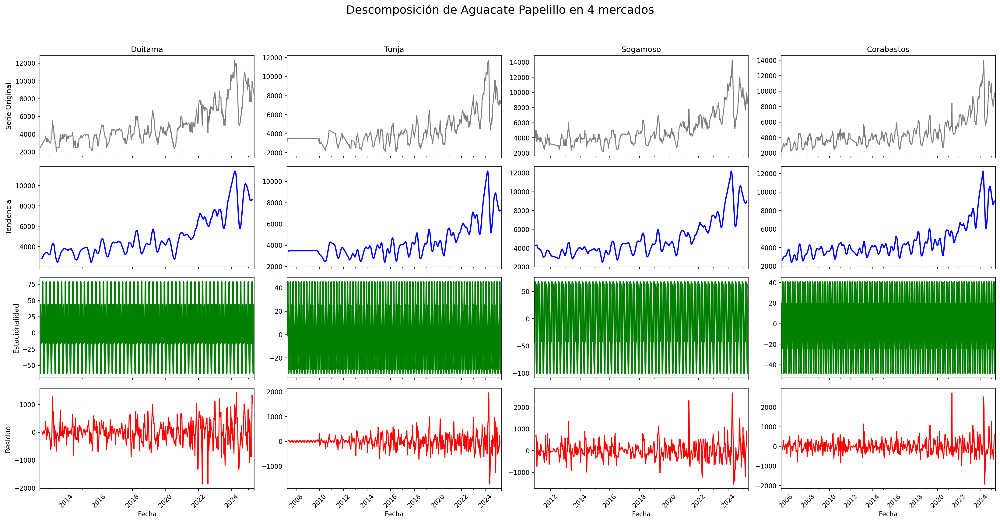

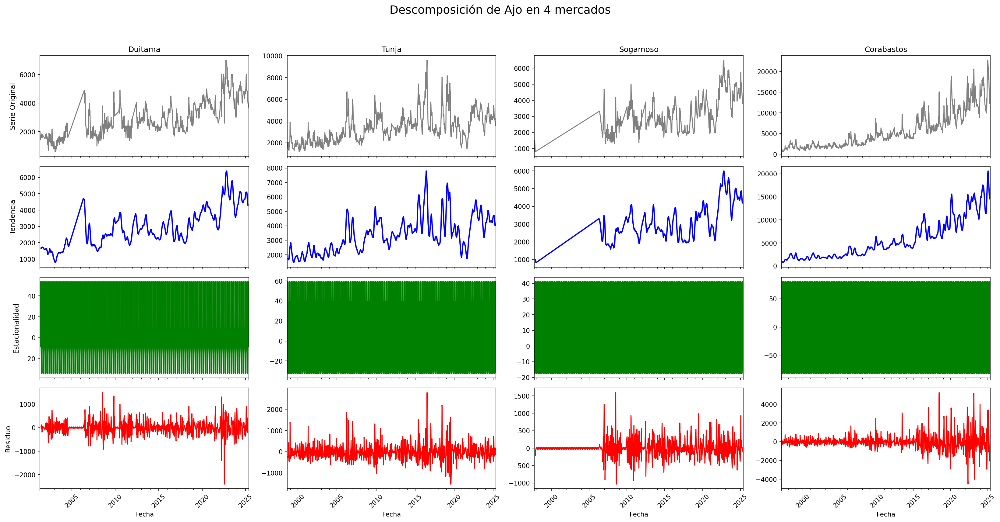

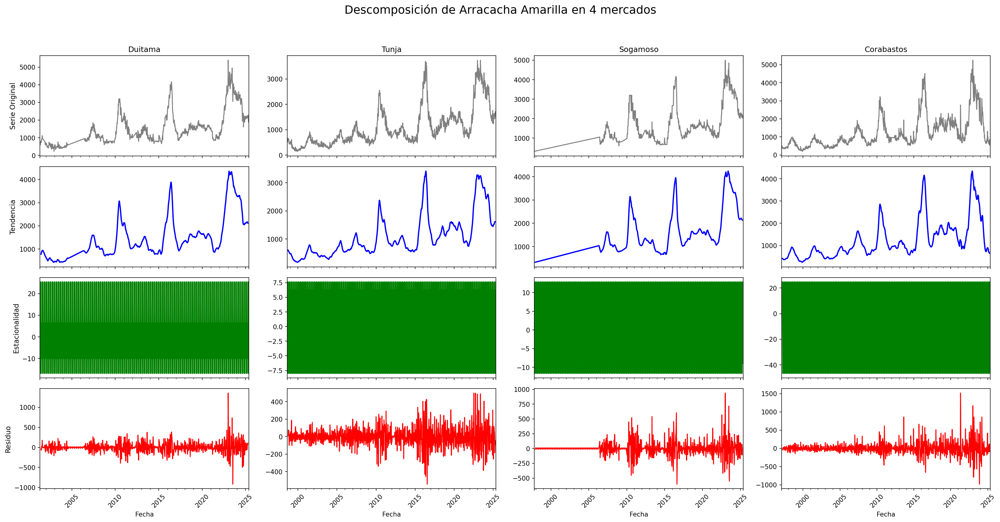

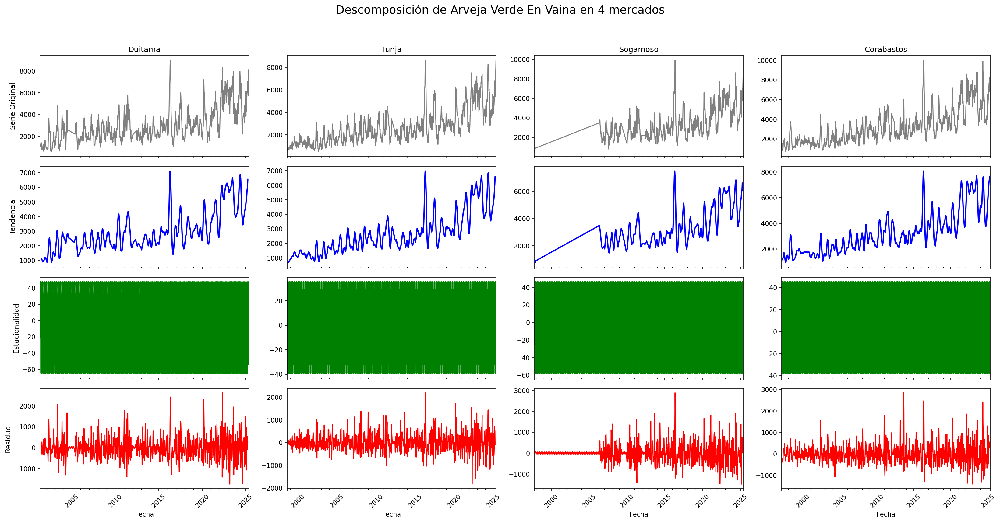

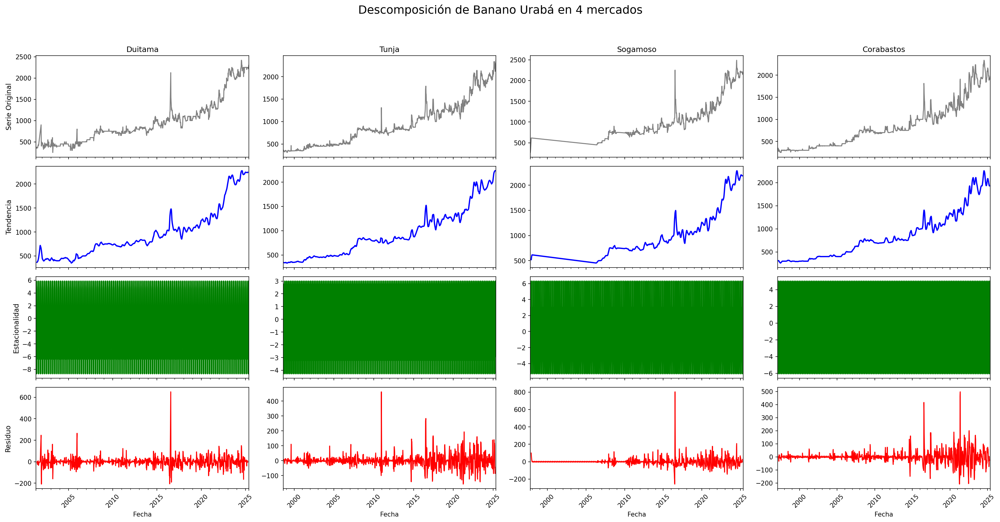

...

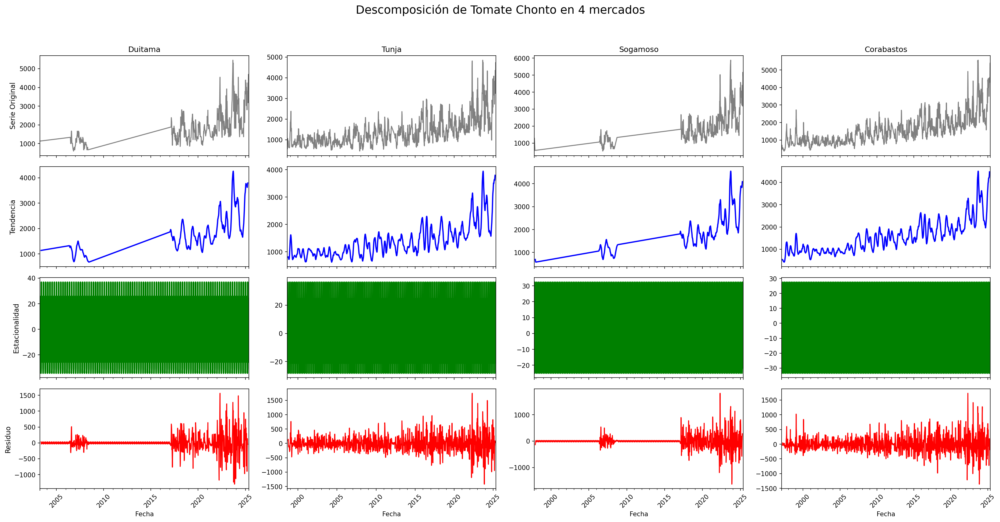

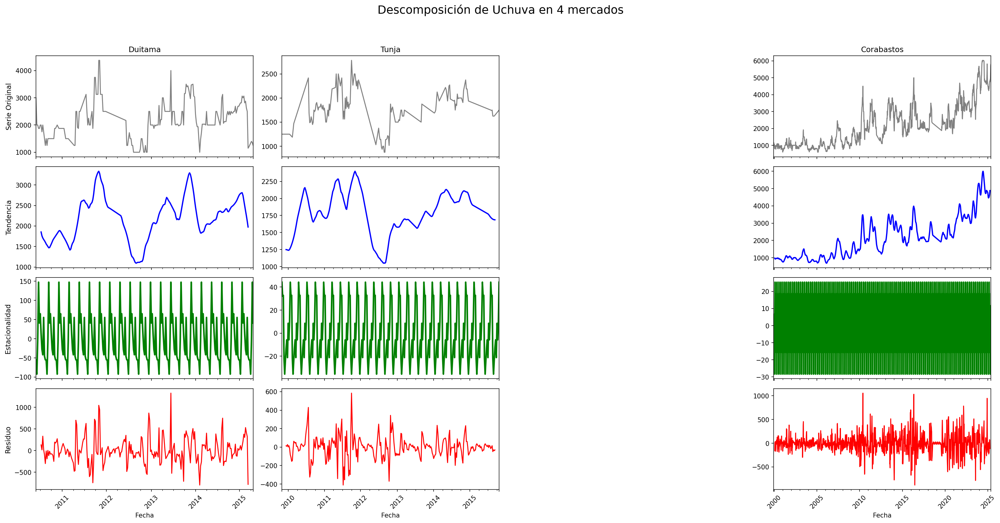

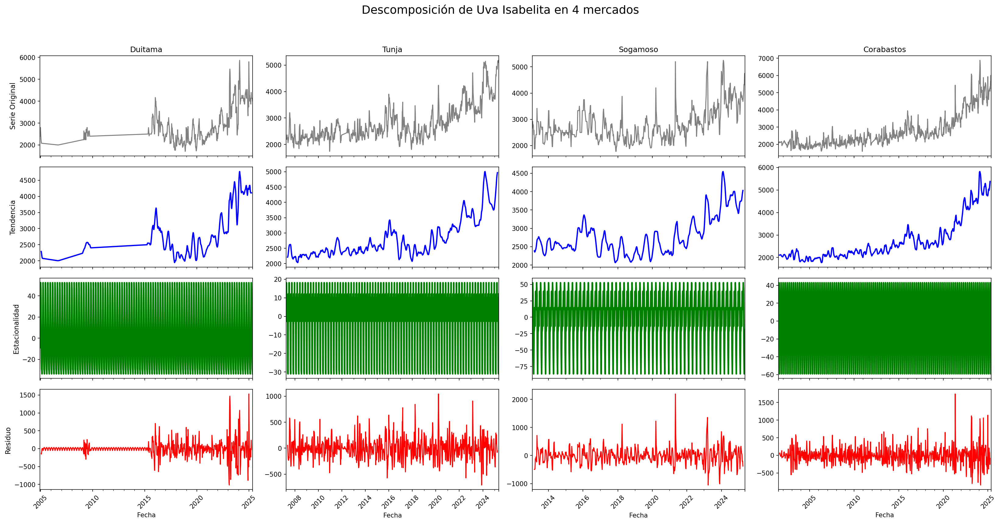

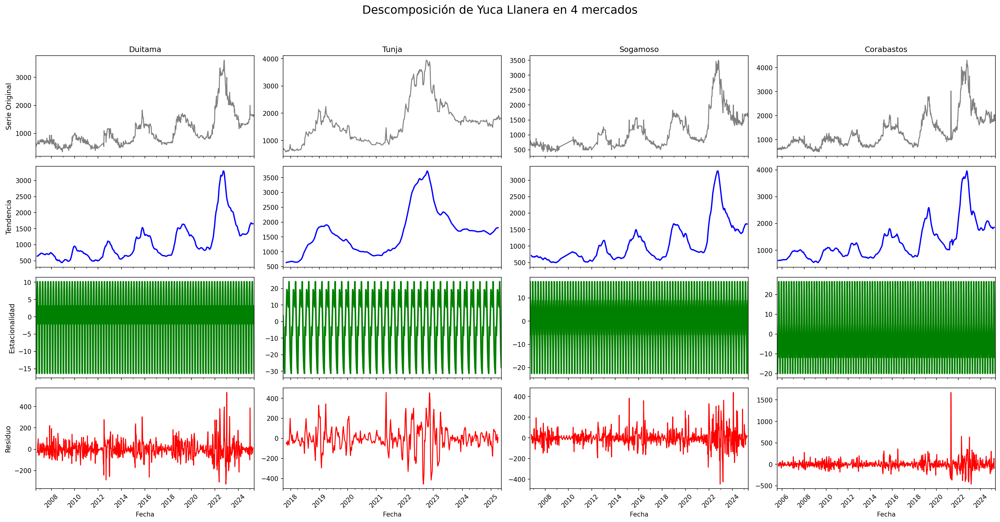

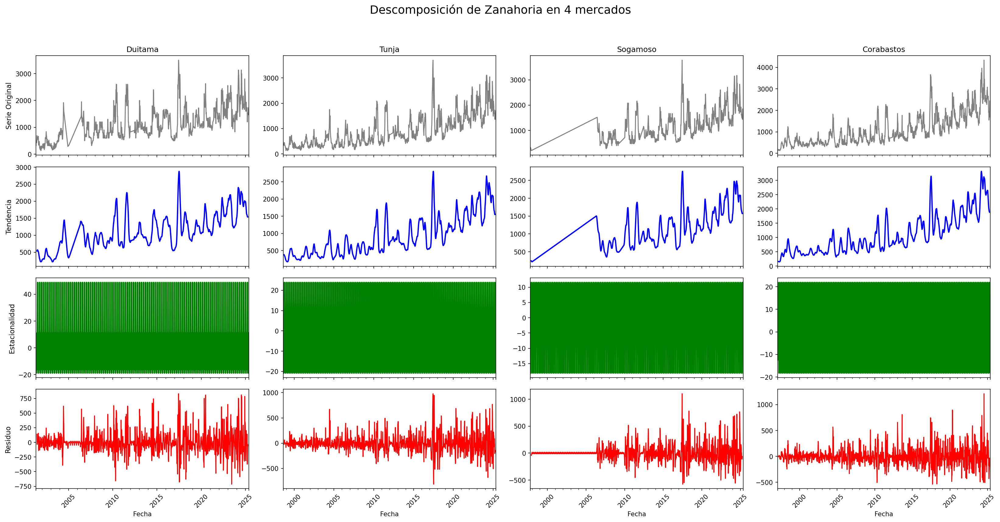

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Leer datos
df_agronet = pd.read_excel("../Data/agronet_final.xlsx")
df_agronet['Fecha'] = pd.to_datetime(df_agronet['Fecha'])

# Normalizar nombres de mercados
reemplazos_mercado = {
    'Duitama (Boyacá)': 'Duitama',
    'Tunja (Boyacá)': 'Tunja',
    'Sogamoso (Boyacá)': 'Sogamoso',
    'Bogotá, D.C., Corabastos': 'Corabastos'
}
df_agronet['Mercado'] = df_agronet['Mercado'].replace(reemplazos_mercado)

mercados_objetivo = list(reemplazos_mercado.values())
productos_comunes = df_agronet[df_agronet['Mercado'].isin(mercados_objetivo)]['Producto'].unique()

# Iterar sobre productos
for producto in productos_comunes:
    fig, axes = plt.subplots(4, len(mercados_objetivo), figsize=(5.5 * len(mercados_objetivo), 12), dpi=150, sharex='col')
    fig.suptitle(f"Descomposición de {producto} en 4 mercados", fontsize=18)

    componentes = ['Serie Original', 'Tendencia', 'Estacionalidad', 'Residuo']

    for j, mercado in enumerate(mercados_objetivo):
        df_prod = df_agronet[(df_agronet['Mercado'] == mercado) & (df_agronet['Producto'] == producto)].copy()
        df_prod = df_prod.sort_values('Fecha')
        df_prod['Precio'] = pd.to_numeric(df_prod['Precio'], errors='coerce')
        df_prod = df_prod.dropna(subset=['Precio'])

        df_resample = df_prod.set_index('Fecha').resample('W')['Precio'].mean().interpolate()

        if len(df_resample) < 12:
            for i in range(4):
                axes[i, j].axis('off')
            continue

        descomp = seasonal_decompose(df_resample, model='additive', period=12)

        datos = [descomp.observed, descomp.trend, descomp.seasonal, descomp.resid]
        colores = ['gray', 'blue', 'green', 'red']
        grosores = [1.5, 2, 2.5, 1.5]

        for i, (serie, color, lw) in enumerate(zip(datos, colores, grosores)):
            serie.plot(ax=axes[i, j], color=color, linewidth=lw)
            if j == 0:
                axes[i, j].set_ylabel(componentes[i], fontsize=11)
            axes[i, j].tick_params(axis='x', rotation=45)

            if i == 0:
                axes[i, j].set_title(mercado, fontsize=12)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


## Generar Tablas promedio con estacionalidad

### Corabastos.

In [ ]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

# Leer datos
df_Com = pd.read_excel("../Data/agronet_final.xlsx")
df_Com['Fecha'] = pd.to_datetime(df_agronet['Fecha'])


mercado_corto = 'Corabastos'

# Filtrar datos para ese mercado
df_mercado = df_agronet[df_agronet['Mercado'] == mercado_corto]

productos = df_mercado['Producto'].unique()

resultados = []

for producto in productos:
    df_prod = df_mercado[df_mercado['Producto'] == producto].copy()
    df_prod = df_prod.sort_values('Fecha')

    df_prod['Precio'] = pd.to_numeric(df_prod['Precio'], errors='coerce')
    df_prod = df_prod.dropna(subset=['Precio'])

    df_resample = df_prod.set_index('Fecha').resample('W')['Precio'].mean().interpolate()

    if len(df_resample) < 12:
        continue

    descomp = seasonal_decompose(df_resample, model='additive', period=12)

    mean_trend = descomp.trend.mean()
    mean_seasonal = descomp.seasonal.mean()
    mean_resid = descomp.resid.abs().mean()

    resultados.append({
        'Mercado': mercado_corto,
        'Producto': producto,
        'Promedio Tendencia': mean_trend,
        'Promedio Estacionalidad': mean_seasonal,
        'Promedio Residuo (abs)': mean_resid
    })

df_resumen = pd.DataFrame(resultados)
#df_resumen = df_resumen.sort_values('Producto').reset_index(drop=True)

df_resumen.head(60)


,Mercado,Producto,Promedio Tendencia,Promedio Estacionalidad,Promedio Residuo (abs)
0,Corabastos,Aguacate Papelillo,4652.126511,-0.121746,241.758683
1,Corabastos,Ajo,5654.941011,-0.009729,462.824084
2,Corabastos,Arracacha Amarilla,1235.160029,0.009119,97.189643
3,Corabastos,Arveja Verde En Vaina,3221.465999,0.004672,299.228038
4,Corabastos,Banano Urabá,847.155613,-0.000977,25.590404
5,Corabastos,Cebolla Cabezona Blanca,1148.037495,-0.014315,120.777727
6,Corabastos,Cebolla Cabezona Roja,1495.892118,-0.006236,130.553919
7,Corabastos,Cebolla puerro,1878.796180,0.022012,189.672564
8,Corabastos,Cilantro,1516.940935,-0.043635,532.501341
9,Corabastos,Durazno Nacional,3933.638017,0.017144,121.469378


### Tunja

In [15]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

# Leer datos
df_agronet = pd.read_excel("../Data/agronet_final.xlsx")
df_agronet['Fecha'] = pd.to_datetime(df_agronet['Fecha'])


mercado_corto = 'Tunja'

# Filtrar datos para ese mercado
df_mercado = df_agronet[df_agronet['Mercado'] == mercado_corto]

productos = df_mercado['Producto'].unique()

resultados = []

for producto in productos:
    df_prod = df_mercado[df_mercado['Producto'] == producto].copy()
    df_prod = df_prod.sort_values('Fecha')

    df_prod['Precio'] = pd.to_numeric(df_prod['Precio'], errors='coerce')
    df_prod = df_prod.dropna(subset=['Precio'])

    df_resample = df_prod.set_index('Fecha').resample('W')['Precio'].mean().interpolate()

    if len(df_resample) < 12:
        continue

    descomp = seasonal_decompose(df_resample, model='additive', period=12)

    mean_trend = descomp.trend.mean()
    mean_seasonal = descomp.seasonal.mean()
    mean_resid = descomp.resid.abs().mean()

    resultados.append({
        'Mercado': mercado_corto,
        'Producto': producto,
        'Promedio Tendencia': mean_trend,
        'Promedio Estacionalidad': mean_seasonal,
        'Promedio Residuo (abs)': mean_resid
    })

df_resumen = pd.DataFrame(resultados)
#df_resumen = df_resumen.sort_values('Producto').reset_index(drop=True)

df_resumen.head(60)

,Mercado,Producto,Promedio Tendencia,Promedio Estacionalidad,Promedio Residuo (abs)
0,Tunja,Aguacate Papelillo,4305.386600,3.119882e-02,183.176357
1,Tunja,Ajo,3394.830594,3.650191e-02,257.905343
2,Tunja,Arracacha Amarilla,1080.770017,2.058699e-03,73.262453
3,Tunja,Arveja Verde En Vaina,2651.798767,-1.103730e-02,282.487195
4,Tunja,Banano Urabá,935.969209,6.898510e-04,25.303806
5,Tunja,Cebolla Cabezona Blanca,985.245461,-4.966382e-02,127.335195
6,Tunja,Cebolla Cabezona Roja,1559.290967,-1.577516e-02,46.116579
7,Tunja,Cilantro,1949.878347,8.648760e-02,594.995385
8,Tunja,Durazno Nacional,2329.055016,-1.995511e-02,142.666461
9,Tunja,Espinaca,1733.267022,-4.314168e-02,186.284505


### Duitama

In [16]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

# Leer datos
df_agronet = pd.read_excel("../Data/agronet_final.xlsx")
df_agronet['Fecha'] = pd.to_datetime(df_agronet['Fecha'])


mercado_corto = 'Duitama'

# Filtrar datos para ese mercado
df_mercado = df_agronet[df_agronet['Mercado'] == mercado_corto]

productos = df_mercado['Producto'].unique()

resultados = []

for producto in productos:
    df_prod = df_mercado[df_mercado['Producto'] == producto].copy()
    df_prod = df_prod.sort_values('Fecha')

    df_prod['Precio'] = pd.to_numeric(df_prod['Precio'], errors='coerce')
    df_prod = df_prod.dropna(subset=['Precio'])

    df_resample = df_prod.set_index('Fecha').resample('W')['Precio'].mean().interpolate()

    if len(df_resample) < 12:
        continue

    descomp = seasonal_decompose(df_resample, model='additive', period=12)

    mean_trend = descomp.trend.mean()
    mean_seasonal = descomp.seasonal.mean()
    mean_resid = descomp.resid.abs().mean()

    resultados.append({
        'Mercado': mercado_corto,
        'Producto': producto,
        'Promedio Tendencia': mean_trend,
        'Promedio Estacionalidad': mean_seasonal,
        'Promedio Residuo (abs)': mean_resid
    })

df_resumen = pd.DataFrame(resultados)
#df_resumen = df_resumen.sort_values('Producto').reset_index(drop=True)

df_resumen.head(60)

,Mercado,Producto,Promedio Tendencia,Promedio Estacionalidad,Promedio Residuo (abs)
0,Duitama,Aguacate Papelillo,5015.041670,-8.127635e-02,299.547335
1,Duitama,Ajo,2980.601793,4.081436e-02,187.928481
2,Duitama,Arracacha Amarilla,1445.408624,-2.912046e-03,80.402610
3,Duitama,Arveja Verde En Vaina,2960.031294,1.098348e-01,359.943934
4,Duitama,Banano Urabá,958.707028,-3.176076e-03,27.257463
5,Duitama,Cebolla Cabezona Blanca,1085.730864,-2.921665e-02,142.063578
6,Duitama,Cilantro,2520.071389,1.261692e-01,728.774466
7,Duitama,Durazno Nacional,4782.830382,-1.685889e+00,286.698763
8,Duitama,Espinaca,2625.665323,1.612241e-01,358.772152
9,Duitama,Feijoba,2321.675259,2.921186e-02,67.855922


### Sogamoso

In [17]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

# Leer datos
df_agronet = pd.read_excel("../Data/agronet_final.xlsx")
df_agronet['Fecha'] = pd.to_datetime(df_agronet['Fecha'])


mercado_corto = 'Sogamoso'

# Filtrar datos para ese mercado
df_mercado = df_agronet[df_agronet['Mercado'] == mercado_corto]

productos = df_mercado['Producto'].unique()

resultados = []

for producto in productos:
    df_prod = df_mercado[df_mercado['Producto'] == producto].copy()
    df_prod = df_prod.sort_values('Fecha')

    df_prod['Precio'] = pd.to_numeric(df_prod['Precio'], errors='coerce')
    df_prod = df_prod.dropna(subset=['Precio'])

    df_resample = df_prod.set_index('Fecha').resample('W')['Precio'].mean().interpolate()

    if len(df_resample) < 12:
        continue

    descomp = seasonal_decompose(df_resample, model='additive', period=12)

    mean_trend = descomp.trend.mean()
    mean_seasonal = descomp.seasonal.mean()
    mean_resid = descomp.resid.abs().mean()

    resultados.append({
        'Mercado': mercado_corto,
        'Producto': producto,
        'Promedio Tendencia': mean_trend,
        'Promedio Estacionalidad': mean_seasonal,
        'Promedio Residuo (abs)': mean_resid
    })

df_resumen = pd.DataFrame(resultados)
#df_resumen = df_resumen.sort_values('Producto').reset_index(drop=True)

df_resumen.head(60)

,Mercado,Producto,Promedio Tendencia,Promedio Estacionalidad,Promedio Residuo (abs)
0,Sogamoso,Aguacate Papelillo,4968.429139,-0.055725,283.494680
1,Sogamoso,Ajo,2798.203160,-0.004098,139.477871
2,Sogamoso,Arracacha Amarilla,1368.608213,0.003671,61.125606
3,Sogamoso,Arveja Verde En Vaina,2978.354372,0.009240,252.858119
4,Sogamoso,Banano Urabá,911.348373,0.002074,21.157504
5,Sogamoso,Cebolla Cabezona Blanca,1025.788527,-0.014481,106.385667
6,Sogamoso,Cebolla Cabezona Roja,1408.981221,0.009121,37.224160
7,Sogamoso,Cilantro,2707.630720,-0.052541,525.564479
8,Sogamoso,Durazno Nacional,3257.034094,-0.016629,261.963339
9,Sogamoso,Espinaca,2625.432910,0.046878,268.504118


### Comparativo entre los cuatro mercados

In [20]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

# Leer datos
df_agronet = pd.read_excel("../Data/agronet_final.xlsx")
df_agronet['Fecha'] = pd.to_datetime(df_agronet['Fecha'])


# Mercados a comparar
mercados_objetivo = ['Duitama', 'Tunja', 'Sogamoso', 'Corabastos']

# Almacena resultados
resultados = []

# Procesar cada mercado y producto
for mercado in mercados_objetivo:
    df_mercado = df_agronet[df_agronet['Mercado'] == mercado]
    productos = df_mercado['Producto'].unique()

    for producto in productos:
        df_prod = df_mercado[df_mercado['Producto'] == producto].copy()
        df_prod = df_prod.sort_values('Fecha')

        df_prod['Precio'] = pd.to_numeric(df_prod['Precio'], errors='coerce')
        df_prod = df_prod.dropna(subset=['Precio'])

        df_resample = df_prod.set_index('Fecha').resample('W')['Precio'].mean().interpolate()

        if len(df_resample) < 12:
            continue

        try:
            descomp = seasonal_decompose(df_resample, model='additive', period=12)
            resultados.append({
                'Producto': producto,
                'Mercado': mercado,
                'Tendencia': descomp.trend.mean(),
                'Estacionalidad': descomp.seasonal.mean(),
                'Residuo': descomp.resid.abs().mean()
            })
        except:
            continue

# Crear DataFrame y pivotearlo
df_resultados = pd.DataFrame(resultados)

# Reorganizar para columnas por mercado
df_pivot = df_resultados.pivot(index='Producto', columns='Mercado', values=['Tendencia', 'Estacionalidad', 'Residuo'])

# Aplanar columnas jerárquicas
df_pivot.columns = [f"{metrica} {mercado}" for metrica, mercado in df_pivot.columns]
df_pivot = df_pivot.reset_index()

# Mostrar los primeros resultados
df_pivot.head(60)


,Producto,Tendencia Corabastos,Tendencia Duitama,Tendencia Sogamoso,Tendencia Tunja,Estacionalidad Corabastos,Estacionalidad Duitama,Estacionalidad Sogamoso,Estacionalidad Tunja,Residuo Corabastos,Residuo Duitama,Residuo Sogamoso,Residuo Tunja
0,Aguacate Papelillo,4652.126511,5015.041670,4968.429139,4305.386600,-0.121746,-8.127635e-02,-0.055725,3.119882e-02,241.758683,299.547335,283.494680,183.176357
1,Ajo,5654.941011,2980.601793,2798.203160,3394.830594,-0.009729,4.081436e-02,-0.004098,3.650191e-02,462.824084,187.928481,139.477871,257.905343
2,Arracacha Amarilla,1235.160029,1445.408624,1368.608213,1080.770017,0.009119,-2.912046e-03,0.003671,2.058699e-03,97.189643,80.402610,61.125606,73.262453
3,Arveja Verde En Vaina,3221.465999,2960.031294,2978.354372,2651.798767,0.004672,1.098348e-01,0.009240,-1.103730e-02,299.228038,359.943934,252.858119,282.487195
4,Banano Urabá,847.155613,958.707028,911.348373,935.969209,-0.000977,-3.176076e-03,0.002074,6.898510e-04,25.590404,27.257463,21.157504,25.303806
5,Cebolla Cabezona Blanca,1148.037495,1085.730864,1025.788527,985.245461,-0.014315,-2.921665e-02,-0.014481,-4.966382e-02,120.777727,142.063578,106.385667,127.335195
6,Cebolla Cabezona Roja,1495.892118,NaN,1408.981221,1559.290967,-0.006236,NaN,0.009121,-1.577516e-02,130.553919,NaN,37.224160,46.116579
7,Cebolla puerro,1878.796180,NaN,NaN,NaN,0.022012,NaN,NaN,NaN,189.672564,NaN,NaN,NaN
8,Cilantro,1516.940935,2520.071389,2707.630720,1949.878347,-0.043635,1.261692e-01,-0.052541,8.648760e-02,532.501341,728.774466,525.564479,594.995385
9,Durazno Nacional,3933.638017,4782.830382,3257.034094,2329.055016,0.017144,-1.685889e+00,-0.016629,-1.995511e-02,121.469378,286.698763,261.963339,142.666461


## Dataset Coomproriente

No presenta muchos datos entonces no se puede hacer un analisis de estacionalidad